# Install and Import Dependencies

In [1]:
pip install torch-summary

Note: you may need to restart the kernel to use updated packages.


In [2]:
import cv2
import glob
import os
import tqdm
import pywt
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchsummary import summary
from torchmetrics import StructuralSimilarityIndexMeasure
from torchmetrics import PeakSignalNoiseRatio

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# Preprocessing

In [3]:
class CustomDataset(Dataset):
    def __init__(self, image_dir, patch_size=(256, 256), image_size=(1024, 1024), noise_std=25):
        super(CustomDataset, self).__init__()
        self.image_dir = image_dir
        self.image_filenames = [x for x in os.listdir(self.image_dir)]
        self.patch_size = patch_size
        self.image_size = image_size
        self.noise_std = noise_std
        self.transform = transforms.Compose([transforms.ToTensor()])

        self.total_patches = 0  # Initialize total patches to zero
        self.all_patches = []  # Store patches for each image

        for filename in self.image_filenames:
            image = cv2.imread(os.path.join(self.image_dir, filename))
            image = cv2.resize(image, self.image_size)
            patches = self.extract_patches(image)
            self.total_patches += len(patches)
            self.all_patches.extend(patches)

    def color_embedding(self, image):
        R, G, B = image[:,:,0], image[:,:,1], image[:,:,2]
        Y = 16 + 65.738*R/256 + 129.057*G/256 + 25.064*B/256
        Cb = 128-37.945*R/256 - 74.494*G/256 + 112.439*B/256
        Cr = 128+112.439*R/256 - 94.154*G/256 - 18.285*B/256
        LL, (LH, HL, HH) = pywt.dwt2(Y, 'db1')
        Cb2 = cv2.resize(Cb, np.transpose(LH).shape)
        Cr2 = cv2.resize(Cr, np.transpose(HL).shape)

        color_embedded = pywt.idwt2((LL, (Cb2, Cr2, HH)), 'db1')
        color_embedded = np.clip(color_embedded, 0, 255).astype('uint8')

        return color_embedded


    def extract_patches(self, image):
        patches = []
        height, width, _ = image.shape
        patch_height, patch_width = self.patch_size

        for i in range(0, height - patch_height + 1, patch_height):
            for j in range(0, width - patch_width + 1, patch_width):
                patch = image[i:i + patch_height, j:j + patch_width, :]
                patches.append(patch)

        return patches

    def __getitem__(self, index): 
        image_data = self.transform(self.color_embedding(self.all_patches[index]))
        image_target = self.transform(self.all_patches[index])
        return image_data, image_target

    def __len__(self):
        return self.total_patches

training_set = CustomDataset('/kaggle/input/div2k-high-resolution-images/DIV2K_train_HR/DIV2K_train_HR')
training_data_loader = DataLoader(
        dataset=training_set, batch_size=16, shuffle=True)
validation_set = CustomDataset('/kaggle/input/div2k-high-resolution-images/DIV2K_valid_HR/DIV2K_valid_HR')
validation_data_loader = DataLoader(
        dataset=validation_set, batch_size=16, shuffle=True)

print(len(training_set), len(training_data_loader))
print(len(validation_set), len(validation_data_loader))

12800 800
1600 100


# Define Network

In [4]:
class ConvBlock(nn.Module):
    def __init__(self, filters, kernel_size, padding, groups, dilation=1, in_channels=1, input=False):
        super().__init__()
        if input:
            self.conv = nn.Conv2d(in_channels=in_channels, out_channels=filters, kernel_size=kernel_size, padding=padding, groups=groups, dilation=dilation)
        else:
            self.conv = nn.Conv2d(in_channels=filters, out_channels=filters, kernel_size=kernel_size, padding=padding, groups=groups, dilation=dilation)
        
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.conv(x)
        x = self.relu(x)
        
        return x

In [5]:
class ResBlock(nn.Module):
    def __init__(self, filters, kernel_size, padding, groups, dilation=1):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels=filters, out_channels=filters, kernel_size=kernel_size, padding=padding, groups=groups, dilation=dilation)
        self.relu1 = nn.ReLU(inplace=True)

        self.conv2 = nn.Conv2d(in_channels=filters, out_channels=filters, kernel_size=kernel_size, padding=padding, groups=groups, dilation=dilation)
        self.relu2 = nn.ReLU(inplace=True)

    def forward(self, x):
        x1 = self.conv1(x)
        x1 = self.relu1(x1)
        
        x1 = self.conv2(x1)

        x1 = x1 + x

        x1 = self.relu2(x1)
        
        return x1

In [6]:
class ADNet(nn.Module):
    def __init__(self, filters, kernel_size, padding, groups):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels=1, out_channels=filters, kernel_size=kernel_size, padding=padding, groups=groups)

        self.resblock1 = ResBlock(filters=filters, kernel_size=kernel_size, padding=padding, groups=groups)
        self.resblock2 = ResBlock(filters=filters, kernel_size=kernel_size, padding=padding, groups=groups)
        self.resblock3 = ResBlock(filters=filters, kernel_size=kernel_size, padding=padding, groups=groups)
        self.resblock4 = ResBlock(filters=filters, kernel_size=kernel_size, padding=padding, groups=groups)

        self.conv2 = nn.Conv2d(in_channels=filters, out_channels=filters, kernel_size=kernel_size, padding=padding, groups=groups)
        self.conv3 = nn.Conv2d(in_channels=filters+1, out_channels=filters, kernel_size=kernel_size, padding=padding, groups=groups)
        self.conv4 = nn.Conv2d(in_channels=filters, out_channels=3, kernel_size=kernel_size, padding=padding, groups=groups)

        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()
        self.tanh = nn.Tanh()
  
    def forward(self, x):
        x1 = self.relu(self.conv1(x))

        x2 = self.resblock1(x1)
        x3 = x1 + x2
        x4 = self.resblock2(x3)
        x5 = x1 + x4
        x6 = self.resblock3(x5)
        x7 = x1 + x6
        x8 = self.resblock4(x7)
        x9 = x1 + x8
        
        x10 = self.conv2(x9)
        x11 = torch.concat((x, x10), dim=1)
        x12 = self.tanh(x11)
        x13 = self.conv3(x12)
        x14 = x13 * x10
        x15 = self.conv4(x14)
        x16 = self.sigmoid(x15 + x)
        
        return x16

In [7]:
network = ADNet(filters=64, kernel_size=3, padding=1, groups=1)
summary(network, input_size=(16, 1, 256, 256))

Layer (type:depth-idx)                   Param #
├─Conv2d: 1-1                            640
├─ResBlock: 1-2                          --
|    └─Conv2d: 2-1                       36,928
|    └─ReLU: 2-2                         --
|    └─Conv2d: 2-3                       36,928
|    └─ReLU: 2-4                         --
├─ResBlock: 1-3                          --
|    └─Conv2d: 2-5                       36,928
|    └─ReLU: 2-6                         --
|    └─Conv2d: 2-7                       36,928
|    └─ReLU: 2-8                         --
├─ResBlock: 1-4                          --
|    └─Conv2d: 2-9                       36,928
|    └─ReLU: 2-10                        --
|    └─Conv2d: 2-11                      36,928
|    └─ReLU: 2-12                        --
├─ResBlock: 1-5                          --
|    └─Conv2d: 2-13                      36,928
|    └─ReLU: 2-14                        --
|    └─Conv2d: 2-15                      36,928
|    └─ReLU: 2-16                     

Layer (type:depth-idx)                   Param #
├─Conv2d: 1-1                            640
├─ResBlock: 1-2                          --
|    └─Conv2d: 2-1                       36,928
|    └─ReLU: 2-2                         --
|    └─Conv2d: 2-3                       36,928
|    └─ReLU: 2-4                         --
├─ResBlock: 1-3                          --
|    └─Conv2d: 2-5                       36,928
|    └─ReLU: 2-6                         --
|    └─Conv2d: 2-7                       36,928
|    └─ReLU: 2-8                         --
├─ResBlock: 1-4                          --
|    └─Conv2d: 2-9                       36,928
|    └─ReLU: 2-10                        --
|    └─Conv2d: 2-11                      36,928
|    └─ReLU: 2-12                        --
├─ResBlock: 1-5                          --
|    └─Conv2d: 2-13                      36,928
|    └─ReLU: 2-14                        --
|    └─Conv2d: 2-15                      36,928
|    └─ReLU: 2-16                     

# Training

In [8]:
#conv biasa bias false
torch.manual_seed(88)

torch.backends.cudnn.benchmark = True
loss = nn.MSELoss()

network = ADNet(filters=64, kernel_size=3, padding=1, groups=1).to('cuda')

optimizer = optim.Adam(network.parameters() ,lr=0.001)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.1)
scheduler2 = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', threshold_mode='abs', factor=0.1, patience=2, threshold=0.1, verbose=True)
scheduler3 = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', threshold_mode='abs', factor=0.1, patience=3, threshold=0.01, verbose=True)

epoch = 16
list_loss = list()
list_psnr = list()
list_ssim = list()

optimizer.zero_grad(set_to_none=True)

psnr = PeakSignalNoiseRatio()
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

for i in range(epoch):
    data_len = len(training_data_loader)
    datas = tqdm.tqdm(enumerate(training_data_loader, 1), total=data_len)
    data_len_valid = len(validation_data_loader)
    datas_valid = tqdm.tqdm(enumerate(validation_data_loader, 1), total=data_len_valid, disable=True)
    
    tot_loss = 0
    tot_ssim = 0
    tot_psnr = 0
    
    for iteration, batch in datas:
        image_a, image_b = batch[0].to('cuda'), batch[1].to('cuda')
        
        output = network(image_a) #forward input ke model
        loss_o = loss(output, image_b) #hitung loss
            
        loss_o.backward() #menghitung gradien dari model
        
        optimizer.step()
        
        optimizer.zero_grad(set_to_none=True)
        tot_loss += loss_o.item()

        datas.set_description(desc='itr: %d/%d [%3d/%3d] Loss: %.6f' % (
                    iteration, data_len, i+1, epoch, tot_loss/max(1, iteration)
                ))
    with torch.no_grad():
        for iteration, batch in datas_valid:
            valid_a, valid_b = batch[0].to('cuda'), batch[1].to('cuda')
            outimg = network(valid_a)
            
            preds = outimg.detach().cpu()
            target = valid_b.detach().cpu()
            
            tot_psnr += psnr(preds, target)
            tot_ssim += ssim(preds, target)
            
    #scheduler.step()
    scheduler3.step(tot_psnr/len(datas_valid))
    
    list_loss.append(tot_loss/data_len) 
    list_psnr.append(tot_psnr/len(datas_valid))
    list_ssim.append(tot_ssim/len(datas_valid))
    print('psnr: {:2f}, ssim: {:2f}\n'.format(list_psnr[i], list_ssim[i]*100))

print('\nmin psnr: {:2f}, average psnr: {:2f}, best psnr: {:2f}'.format(min(list_psnr), sum(list_psnr)/len(list_psnr), max(list_psnr)))
print('min ssim: {:2f}, average ssim: {:2f}, best ssim: {:2f}'.format(min(list_ssim)*100, sum(list_ssim)/len(list_ssim)*100, max(list_ssim)*100))

/opt/conda/lib/python3.10/site-packages/torchmetrics/utilities/prints.py:62: FutureWarning: Importing `PeakSignalNoiseRatio` from `torchmetrics` was deprecated and will be removed in 2.0. Import `PeakSignalNoiseRatio` from `torchmetrics.image` instead.
  _future_warning(
/opt/conda/lib/python3.10/site-packages/torchmetrics/utilities/prints.py:62: FutureWarning: Importing `StructuralSimilarityIndexMeasure` from `torchmetrics` was deprecated and will be removed in 2.0. Import `StructuralSimilarityIndexMeasure` from `torchmetrics.image` instead.
  _future_warning(
itr: 800/800 [  1/ 16] Loss: 0.003659: 100%|██████████| 800/800 [05:22<00:00,  2.48it/s]


psnr: 28.270515, ssim: 89.434128



itr: 800/800 [  2/ 16] Loss: 0.001589: 100%|██████████| 800/800 [05:13<00:00,  2.55it/s]


psnr: 28.592085, ssim: 90.167717



itr: 800/800 [  3/ 16] Loss: 0.001442: 100%|██████████| 800/800 [05:15<00:00,  2.54it/s]


psnr: 29.056120, ssim: 90.492317



itr: 800/800 [  4/ 16] Loss: 0.001400: 100%|██████████| 800/800 [05:11<00:00,  2.57it/s]


psnr: 28.719038, ssim: 89.661469



itr: 800/800 [  5/ 16] Loss: 0.001341: 100%|██████████| 800/800 [05:12<00:00,  2.56it/s]


psnr: 29.397915, ssim: 91.000824



itr: 800/800 [  6/ 16] Loss: 0.001304: 100%|██████████| 800/800 [05:13<00:00,  2.55it/s]


psnr: 29.080940, ssim: 89.565109



itr: 800/800 [  7/ 16] Loss: 0.001257: 100%|██████████| 800/800 [05:12<00:00,  2.56it/s]


psnr: 29.644123, ssim: 91.631874



itr: 800/800 [  8/ 16] Loss: 0.001228: 100%|██████████| 800/800 [05:17<00:00,  2.52it/s]


psnr: 29.837513, ssim: 91.719414



itr: 800/800 [  9/ 16] Loss: 0.001187: 100%|██████████| 800/800 [05:15<00:00,  2.54it/s]


psnr: 29.735073, ssim: 91.516006



itr: 800/800 [ 10/ 16] Loss: 0.001171: 100%|██████████| 800/800 [05:12<00:00,  2.56it/s]


psnr: 29.929144, ssim: 91.976967



itr: 800/800 [ 11/ 16] Loss: 0.001158: 100%|██████████| 800/800 [05:14<00:00,  2.54it/s]


psnr: 29.433577, ssim: 91.494606



itr: 800/800 [ 12/ 16] Loss: 0.001138: 100%|██████████| 800/800 [05:14<00:00,  2.55it/s]


psnr: 30.085608, ssim: 92.152580



itr: 800/800 [ 13/ 16] Loss: 0.001106: 100%|██████████| 800/800 [05:13<00:00,  2.55it/s]


psnr: 29.903664, ssim: 92.240837



itr: 800/800 [ 14/ 16] Loss: 0.001089: 100%|██████████| 800/800 [05:15<00:00,  2.53it/s]


psnr: 30.151714, ssim: 92.347801



itr: 800/800 [ 15/ 16] Loss: 0.001090: 100%|██████████| 800/800 [05:13<00:00,  2.55it/s]


psnr: 30.232105, ssim: 92.354942



itr: 800/800 [ 16/ 16] Loss: 0.001079: 100%|██████████| 800/800 [05:13<00:00,  2.55it/s]


psnr: 29.880617, ssim: 92.186729


min psnr: 28.270515, average psnr: 29.496857, best psnr: 30.232105
min ssim: 89.434128, average ssim: 91.246460, best ssim: 92.354942


In [9]:
torch.save(network.state_dict(), '/kaggle/working/ADNet.pth')

# Testing

In [10]:
# network = ResNetADNet(filters=64, kernel_size=3, padding=1, groups=1).to('cuda')
# network.load_state_dict(torch.load('/kaggle/input/save-model-color-embedded/3107.pth'))

# network.eval()

In [20]:
def color_embedding(RGBImage):
    R, G, B = RGBImage[:,:,0], RGBImage[:,:,1], RGBImage[:,:,2]
    Y = 16 + 65.738*R/256 + 129.057*G/256 + 25.064*B/256
    Cb = 128-37.945*R/256 - 74.494*G/256 + 112.439*B/256
    Cr = 128+112.439*R/256 - 94.154*G/256 - 18.285*B/256
    LL, (LH, HL, HH) = pywt.dwt2(Y, 'db1')
    Cb2 = cv2.resize(Cb, np.transpose(LH).shape)
    Cr2 = cv2.resize(Cr, np.transpose(HL).shape)

    color_embedded = pywt.idwt2((LL, (Cb2, Cr2, HH)), 'db1')
    color_embedded = np.clip(color_embedded, 0, 255).astype('uint8')
    
    return color_embedded

In [21]:
filelist_test = glob.glob('/kaggle/input/kodak-dataset/*.png')
test_images = np.array([np.expand_dims(color_embedding(np.array((Image.open(fname).resize((512, 512)))))/255., axis=0) for fname in filelist_test])
test_targets = np.array([(np.array(Image.open(fname).resize((512, 512)))/255.0).transpose(2, 0, 1) for fname in filelist_test])

In [22]:
test_loader = torch.utils.data.DataLoader(
    test_images,
    batch_size=1
)

test_targets_loader = torch.utils.data.DataLoader(
    test_targets,
    batch_size=1
)

In [23]:
list_ssim = []
list_psnr = []
tot_psnr = 0
tot_ssim = 0
for i in range(24):
    ssim_value = 0
    psnr_value = 0
    
    img = Image.open(f'/kaggle/input/kodak-dataset/kodim{i+1:02d}.png')
    image_np = np.array(img)
    ori_img_tensor = torchvision.transforms.functional.to_tensor(image_np)
    ori_img_tensor_batched = torch.unsqueeze(ori_img_tensor, dim=0)
    color_embedded = color_embedding(image_np)
    img_tensor = torchvision.transforms.functional.to_tensor(color_embedded)
    batched_img = torch.unsqueeze(img_tensor, dim=0).to('cuda')
    with torch.no_grad():
        new_img = network(batched_img)
        
    preds = new_img.detach().cpu()
    target = ori_img_tensor_batched.detach().cpu()
    
    ssim = StructuralSimilarityIndexMeasure(data_range=1.0)
    ssim_value = ssim(preds, target)
    list_ssim.append(ssim_value)
    tot_ssim += ssim_value
    
    psnr = PeakSignalNoiseRatio()
    psnr_value = psnr(preds, target)
    list_psnr.append(psnr_value)
    tot_psnr += psnr_value

print(f'PSNR max: {max(list_psnr)} SSIM max: {max(list_ssim)}')
print(f'PSNR avg: {tot_psnr/24} SSIM avg: {tot_ssim/24}')
print(f'PSNR min: {min(list_psnr)} SSIM min: {min(list_ssim)}')

PSNR max: 33.818267822265625 SSIM max: 0.9628406167030334
PSNR avg: 30.54094696044922 SSIM avg: 0.91143798828125
PSNR min: 25.1290340423584 SSIM min: 0.8347831964492798


In [30]:
original_images = []
grayscale_images = []
prediction_images = []

for image, label in zip(test_loader, test_targets_loader):
  image = image.to('cuda')
  
  with torch.no_grad():
    test_pred = network(image.float())

  original_images.append(label.squeeze().tolist())
  grayscale_images.append(image.squeeze().tolist())
  prediction_images.append(test_pred.squeeze().detach().cpu().tolist())

original_images = np.array(original_images)
grayscale_images = np.array(grayscale_images)
prediction_images = np.array(prediction_images)

original_images = original_images.transpose((0, 2, 3, 1))
prediction_images = prediction_images.transpose((0, 2, 3, 1))

print(original_images.shape)
print(grayscale_images.shape)
print(prediction_images.shape)

(24, 512, 512, 3)
(24, 512, 512)
(24, 512, 512, 3)


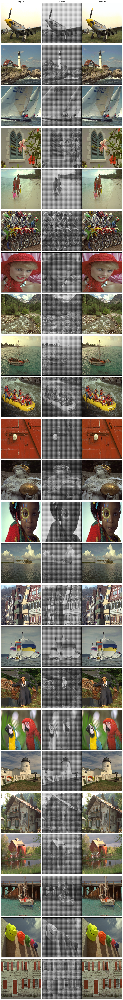

In [32]:
titles = ['Original', 'Grayscale', 'Prediction']
fig = plt.figure(figsize=(12, 96))

for i in range(len(test_images)):
  images = [original_images[i], grayscale_images[i], prediction_images[i]]

  for j, a in enumerate(images):
    ax = fig.add_subplot(len(test_images), 3, j + 1 + 3 * i)
    if j == 1:
        ax.imshow(a, cmap=plt.cm.gray)
    else:
        ax.imshow(a)
    
    if i == 0:
      ax.set_title(titles[j], fontsize=10)

    ax.set_xticks([])
    ax.set_yticks([])

fig.tight_layout()
plt.show()